# Nasa engine maintenance

The goal of this challenge is to predict the RUL (Remaining Useful Life) of turbofan engines.

The dataset consists of different multivariate time-series. These different time-series refer to different engines (engineno in the dataset). The sampling of the time series is 1 point per engine cycle (timein_cycles in the dataset).

## Import libraries

In [1]:
# import standard libraries
import pandas as pd
import numpy as np
from numpy import array
from pandas_profiling import ProfileReport
from tqdm import tqdm
import time
import os
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import sys
import icecream as ic
warnings.filterwarnings('ignore')

# import time series eda libraries
from statsmodels.tsa.seasonal import seasonal_decompose

# import sklearn libraries
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split as tts

# import keras libraries
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping

%matplotlib inline

## Import data

In [2]:
train_data = pd.read_csv('../../data/predictive-maintenance/train_FD001.txt', sep=" ", header=None)

In [17]:
train_data.isna().sum()

0         0
1         0
2         0
3         0
4         0
5         0
6         0
7         0
8         0
9         0
10        0
11        0
12        0
13        0
14        0
15        0
16        0
17        0
18        0
19        0
20        0
21        0
22        0
23        0
24        0
25        0
26    20631
27    20631
dtype: int64

In [3]:
rul_data = pd.read_csv('../../data/predictive-maintenance/RUL_FD001.txt', sep=" ", header=None)
rul_data.head()

,0,1
0,112,NaN
1,98,NaN
2,69,NaN
3,82,NaN
4,91,NaN


In [4]:
test_data = pd.read_csv('../../data/predictive-maintenance/test_FD001.txt', sep=" ", header=None)
test_data.head()

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN


## EDA

Data sets consists of multiple multivariate time series. Each data set is further divided into training and test subsets. Each time series is from a different engine � i.e., the data can be considered to be from a fleet of engines of the same type. Each engine starts with different degrees of initial wear and manufacturing variation which is unknown to the user. This wear and variation is considered normal, i.e., it is not considered a fault condition. There are three operational settings that have a substantial effect on engine performance. These settings are also included in the data. The data is contaminated with sensor noise.

In [10]:
report=ProfileReport(train_data)
report

## Data cleaning

As each of the data files contains multiple timeseries data (engine numbers), the data must be separated into chunks which can be dealt with sequentially as the engine number may be important but the primary object is to create an algorithm which can provide the number of cycles left. The relevance of the engine number (which may be a proxy for the age) can be implemented later.
As noted earlier, the sensor data is noisy and will require being put through filter/MA/gaussian denoising algorithms to have a more stable signal.

In [5]:
# Dealing with missing values
train_data_filled=train_data.interpolate()
train_data_filled[26]=train_data_filled[26].fillna(0)
train_data_filled[27]=train_data_filled[27].fillna(0)

In [6]:
from sklearn.preprocessing import StandardScaler

sc=StandardScaler()
sc.fit(train_data_filled.iloc[:,2:])
train_data_sc=train_data_filled
train_data_sc.iloc[:,2:]=sc.transform(train_data_filled.iloc[:,2:])

In [7]:
engines=[]
for a in train_data_sc[0].unique():
    engines.append(train_data_sc[train_data_sc[0]==a])

In [8]:
# for each sample, add the number of cycles left until the fault appears and separate RUL
y=[]
for e in engines:
    e.set_index(1)
    y.append(e[1].shape[0]-e[1])
    e.drop([0],axis=1,inplace=True)
    e.drop([1],axis=1,inplace=True)
engines[0]

,2,3,4,5,6,7,8,9,10,11,...,18,19,20,21,22,23,24,25,26,27
0,-0.315980,-1.372953,0.0,0.0,-1.721725,-0.134255,-0.925936,-1.0,0.141683,1.121141,...,-0.269071,-0.603816,-1.0,-0.781710,0.0,0.0,1.348493,1.194427,0.0,0.0
1,0.872722,-1.031720,0.0,0.0,-1.061780,0.211528,-0.643726,-1.0,0.141683,0.431930,...,-0.642845,-0.275852,-1.0,-0.781710,0.0,0.0,1.016528,1.236922,0.0,0.0
2,-1.961874,1.015677,0.0,0.0,-0.661813,-0.413166,-0.525953,-1.0,0.141683,1.008155,...,-0.551629,-0.649144,-1.0,-2.073094,0.0,0.0,0.739891,0.503423,0.0,0.0
3,0.324090,-0.008022,0.0,0.0,-0.661813,-1.261314,-0.784831,-1.0,0.141683,1.222827,...,-0.520176,-1.971665,-1.0,-0.781710,0.0,0.0,0.352598,0.777792,0.0,0.0
4,-0.864611,-0.690488,0.0,0.0,-0.621816,-1.251528,-0.301518,-1.0,0.141683,0.714393,...,-0.521748,-0.339845,-1.0,-0.136018,0.0,0.0,0.463253,1.059552,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187,-3.059137,1.015677,0.0,0.0,2.137957,1.933923,1.538403,-1.0,0.141683,-1.613104,...,-1.366278,2.094554,-1.0,1.801059,0.0,0.0,-1.694518,-3.056912,0.0,0.0
188,-0.270260,0.674444,0.0,0.0,2.997886,0.921037,2.119489,-1.0,0.141683,-3.014122,...,-1.375714,2.030561,-1.0,1.155367,0.0,0.0,-1.860500,-1.635180,0.0,0.0
189,-1.230366,0.333211,0.0,0.0,1.917975,1.418509,1.890610,-1.0,0.141683,-2.347508,...,-1.634158,2.137216,-1.0,3.092444,0.0,0.0,-1.805173,-2.052739,0.0,0.0
190,0.004055,-1.372953,0.0,0.0,1.318024,1.930661,1.870611,-1.0,0.141683,-2.765554,...,-1.527740,2.006564,-1.0,0.509675,0.0,0.0,-2.026483,-1.479981,0.0,0.0


In [9]:
# Deal with the noise
from tsmoothie.smoother import LowessSmoother

for e in engines:
    smoother = LowessSmoother(smooth_fraction=0.1, iterations=1)
    smoother.smooth(e)

## Modeling

In [39]:
from sklearn.linear_model import LinearRegression
y_dataframe=pd.DataFrame(np.array([item for sublist in y for item in sublist if isinstance(item, int)]))

In [41]:
from sklearn.metrics import mean_squared_error as mse
X_train,X_test,y_train,y_test=train_test_split(train_data_sc.drop([0,1],axis=1),y_dataframe,train_size=0.8,shuffle=True,random_state=123)
lr=LinearRegression()
lr.fit(X_train,y_train)
ypred_tr=lr.predict(X_train)
ypred_te=lr.predict(X_test)
print(mse(y_train,ypred_tr))
print(mse(y_test,ypred_te))


1967.8157543703153
2103.2519581122215


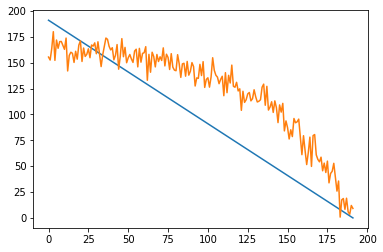

In [119]:
y_pred=lr.predict(engines[0])
plt.plot(y[0])
plt.plot(y_pred)

In [121]:
from sklearn.neighbors import KNeighborsRegressor
knr = KNeighborsRegressor(n_neighbors=10)
knr.fit(X_train, y_train)
ypred_tr=knr.predict(X_train)
ypred_te=knr.predict(X_test)
print(mse(y_train,ypred_tr))
print(mse(y_test,ypred_te))

1542.2154132331557
1980.5219505694208


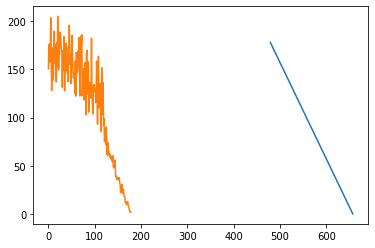

In [129]:
y_pred=knr.predict(engines[2])
plt.plot(y[2])
plt.plot(y_pred)

In [134]:
from sklearn.svm import SVR

# Create a support vector machine for regression with a linear kernel
svr = SVR(kernel="rbf")
svr.fit(X_train, y_train)
ypred_tr=svr.predict(X_train)
ypred_te=svr.predict(X_test)
print(mse(y_train,ypred_tr))
print(mse(y_test,ypred_te))
y_pred=svr.predict(engines[2])
plt.plot(y[2].reset_index())
plt.plot(y_pred)

ValueError: setting an array element with a sequence.

In [66]:
output=y

In [100]:
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test=train_test_split(engines,output,train_size=0.8,random_state=123)


In [101]:
for i in range(len(X_train)):
    X = []
    y = []
    datax=np.array(X_train[i])
    datay=np.array(y_train[i])
    for j in range(2, datax.shape[0]):
        X.append(datax[j-2:j, :])
        y.append(datay[j,])
    X, y = np.array(X), np.array(y).reshape(np.array(y).shape[0],1)
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))
    y_train[i]=y
    X_train[i]=X

In [102]:
for i in range(len(X_test)):
    X = []
    y = []
    datax=np.array(X_test[i])
    datay=np.array(y_test[i])
    for j in range(2, datax.shape[0]):
        X.append(datax[j-2:j, :])
        y.append(datay[j,])
    X, y = np.array(X), np.array(y).reshape(np.array(y).shape[0],1)
    X = np.reshape(X, (X.shape[0], X.shape[1], X.shape[2]))
    y_test[i]=y
    X_test[i]=X


In [144]:
model = Sequential()#Adding the first LSTM layer and some Dropout regularisation
model.add(LSTM(units = 50, return_sequences = True, input_shape = ( X_train[0].shape[1],X_train[0].shape[2])))
model.add(Dropout(0.1))# Adding a second LSTM layer and some Dropout regularisation
model.add(LSTM(units = 50, return_sequences = True))
model.add(Dropout(0.1))# Adding a third LSTM layer and some Dropout regularisation
model.add(LSTM(units = 50, return_sequences = True))
model.add(Dropout(0.1))# Adding a fourth LSTM layer and some Dropout regularisation
model.add(LSTM(units = 50))
model.add(Dropout(0.1))# Adding the output layer
model.add(Dense(units = 1))

# Compiling the RNN
model.compile(optimizer = 'adam', loss = 'mean_squared_logarithmic_error')



In [147]:
# Fitting the RNN to the Training set
from tqdm import tqdm
for j in tqdm(range(100)): 
    for i in range(len(X_train)):
        model.train_on_batch(X_train[i], y_train[i],reset_metrics=False)

100%|██████████| 100/100 [02:05<00:00,  1.26s/it]


461.65128402071196


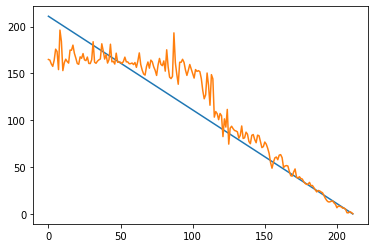

In [150]:
from sklearn.metrics import mean_squared_error as mse
ypred_te=model.predict(X_test[8])
print(mse(y_test[8],ypred_te))
plt.plot(y_test[8])
plt.plot(ypred_te)